# Importing libraries and dataset

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
#import lightgbm as lgb
#import datetime as dt
#import calendar,warnings,itertools,matplotlib
#import statsmodels.api as sm
from datetime import datetime
from sklearn.model_selection import train_test_split,cross_val_score #, cross_val_predict
from sklearn import metrics,tree,preprocessing#,linear_model
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.metrics import accuracy_score,recall_score,confusion_matrix,f1_score,roc_curve#, auc
import warnings
#Hiding the warnings
warnings.filterwarnings('ignore') 


In [2]:
import os
os.getcwd()

'C:\\Users\\nitish\\Downloads'

In [3]:
os.chdir("D:\MSc_Komal\Sem2\PDA")

In [4]:
os.getcwd()

'D:\\MSc_Komal\\Sem2\\PDA'

In [5]:
df=pd.read_csv("D:\MSc_Komal\Sem2\PDA\Data.csv")
df.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,...,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,02-03-2018 22:56,Standard Class
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/18/2018 12:27,Standard Class
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/17/2018 12:06,Standard Class
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/16/2018 11:45,Standard Class
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/15/2018 11:24,Standard Class


# Exploratory Data Analysis and Preprocessing

In [6]:
df.shape

(180519, 53)

Data set has 180519 records and 53 columns

In [7]:
df.describe()

,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Late_delivery_risk,Category Id,Customer Id,Customer Zipcode,Department Id,Latitude,...,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Price,Product Status
count,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180519.000000,180516.000000,180519.000000,180519.000000,...,180519.000000,180519.000000,180519.000000,180519.000000,24840.000000,180519.000000,180519.000000,0.0,180519.000000,180519.0
mean,3.497654,2.931847,21.974989,183.107609,0.548291,31.851451,6691.379495,35921.126914,5.443460,29.719955,...,2.127638,203.772096,183.107609,21.974989,55426.132327,692.509764,31.851451,NaN,141.232550,0.0
std,1.623722,1.374449,104.433526,120.043670,0.497664,15.640064,4162.918106,37542.461122,1.629246,9.813646,...,1.453451,132.273077,120.043670,104.433526,31919.279101,336.446807,15.640064,NaN,139.732492,0.0
min,0.000000,0.000000,-4274.979980,7.490000,0.000000,2.000000,1.000000,603.000000,2.000000,-33.937553,...,1.000000,9.990000,7.490000,-4274.979980,1040.000000,19.000000,2.000000,NaN,9.990000,0.0
25%,2.000000,2.000000,7.000000,104.379997,0.000000,18.000000,3258.500000,725.000000,4.000000,18.265432,...,1.000000,119.980003,104.379997,7.000000,23464.000000,403.000000,18.000000,NaN,50.000000,0.0
50%,3.000000,4.000000,31.520000,163.990005,1.000000,29.000000,6457.000000,19380.000000,5.000000,33.144863,...,1.000000,199.919998,163.990005,31.520000,59405.000000,627.000000,29.000000,NaN,59.990002,0.0
75%,5.000000,4.000000,64.800003,247.399994,1.000000,45.000000,9779.000000,78207.000000,7.000000,39.279617,...,3.000000,299.950012,247.399994,64.800003,90008.000000,1004.000000,45.000000,NaN,199.990005,0.0
max,6.000000,4.000000,911.799988,1939.989990,1.000000,76.000000,20757.000000,99205.000000,12.000000,48.781933,...,5.000000,1999.989990,1939.989990,911.799988,99301.000000,1363.000000,76.000000,NaN,1999.989990,0.0


## Checking column with NULL values

In [8]:
df.isnull().mean()*100

Type                               0.000000
Days for shipping (real)           0.000000
Days for shipment (scheduled)      0.000000
Benefit per order                  0.000000
Sales per customer                 0.000000
Delivery Status                    0.000000
Late_delivery_risk                 0.000000
Category Id                        0.000000
Category Name                      0.000000
Customer City                      0.000000
Customer Country                   0.000000
Customer Email                     0.000000
Customer Fname                     0.000000
Customer Id                        0.000000
Customer Lname                     0.004432
Customer Password                  0.000000
Customer Segment                   0.000000
Customer State                     0.000000
Customer Street                    0.000000
Customer Zipcode                   0.001662
Department Id                      0.000000
Department Name                    0.000000
Latitude                        

The data set has missing values in the columns Order Zipcode,Product Description,Customer Zipcode and Customer Lname which should be removed or filled with blank values before preceeding with the model building process.

from scipy import stats
df['zscore']=stats.zscore(df)
#df[(np.abs(stats.zscore(df)) < 3).all(axis=1)]

Merging 'Customer fname' and 'Customer Lname' to a new column Customer_Name to avoid any confusion as two person can have a same first name.

In [9]:
df['Customer_Name'] = df['Customer Fname'].astype(str)+df['Customer Lname'].astype(str)

To ease the model building process we are dropping the columns with less important data.

In [10]:
df=df.drop(['Customer Email','Product Status','Customer Password','Customer Street','Customer Fname','Customer Lname',
           'Latitude','Longitude','Product Description','Product Image','Order Zipcode','shipping date (DateOrders)'],axis=1)
df.shape

(180519, 42)

In [11]:
df.isnull().mean()*100

Type                             0.000000
Days for shipping (real)         0.000000
Days for shipment (scheduled)    0.000000
Benefit per order                0.000000
Sales per customer               0.000000
Delivery Status                  0.000000
Late_delivery_risk               0.000000
Category Id                      0.000000
Category Name                    0.000000
Customer City                    0.000000
Customer Country                 0.000000
Customer Id                      0.000000
Customer Segment                 0.000000
Customer State                   0.000000
Customer Zipcode                 0.001662
Department Id                    0.000000
Department Name                  0.000000
Market                           0.000000
Order City                       0.000000
Order Country                    0.000000
Order Customer Id                0.000000
order date (DateOrders)          0.000000
Order Id                         0.000000
Order Item Cardprod Id           0

In [12]:
df.dtypes

Type                              object
Days for shipping (real)           int64
Days for shipment (scheduled)      int64
Benefit per order                float64
Sales per customer               float64
Delivery Status                   object
Late_delivery_risk                 int64
Category Id                        int64
Category Name                     object
Customer City                     object
Customer Country                  object
Customer Id                        int64
Customer Segment                  object
Customer State                    object
Customer Zipcode                 float64
Department Id                      int64
Department Name                   object
Market                            object
Order City                        object
Order Country                     object
Order Customer Id                  int64
order date (DateOrders)           object
Order Id                           int64
Order Item Cardprod Id             int64
Order Item Disco

There are only missing values in zipcode and the datatype of the zipcode is float so, we will fill the missing values with zero in zipcode before proceeding with model building process.

In [13]:
df['Customer Zipcode']=df['Customer Zipcode'].fillna(0)

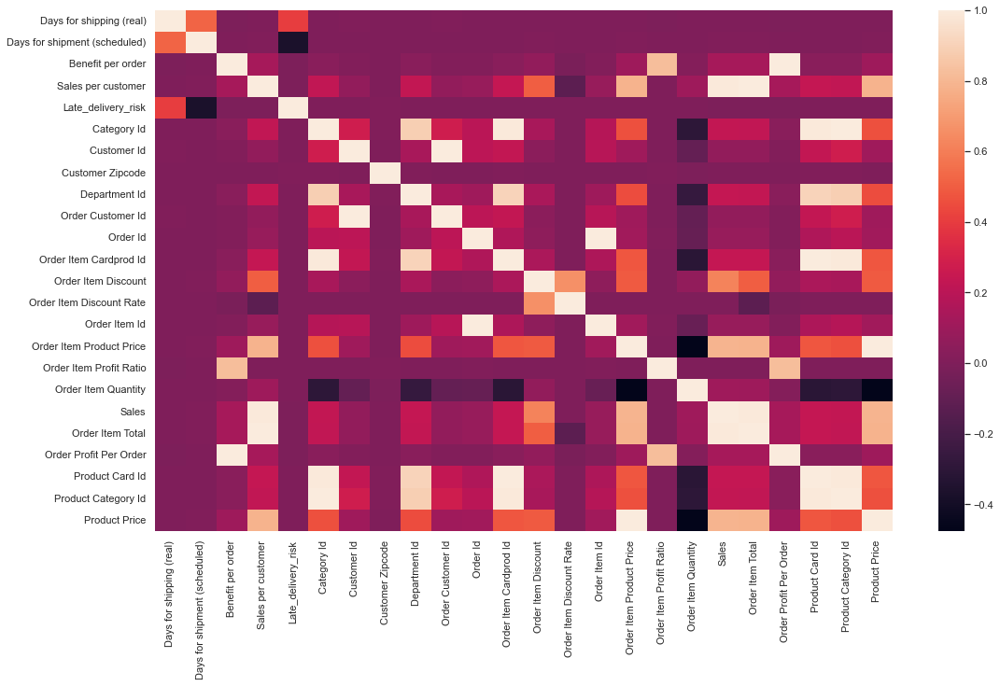

In [14]:
sns.set(rc={'figure.figsize':(17.7,10.27)})
sns.heatmap(df.corr(), annot=False);
# sns.pairplot(df)
# sns.plt.show()

From the heatmap, it is clearly visible that the Product Price has high correlation with Sales and Order Item Total. So, we will explore regions related to this.We will try to find out the region with the highest sales.

<AxesSubplot:title={'center':'Market wise total Sales'}, xlabel='Market'>

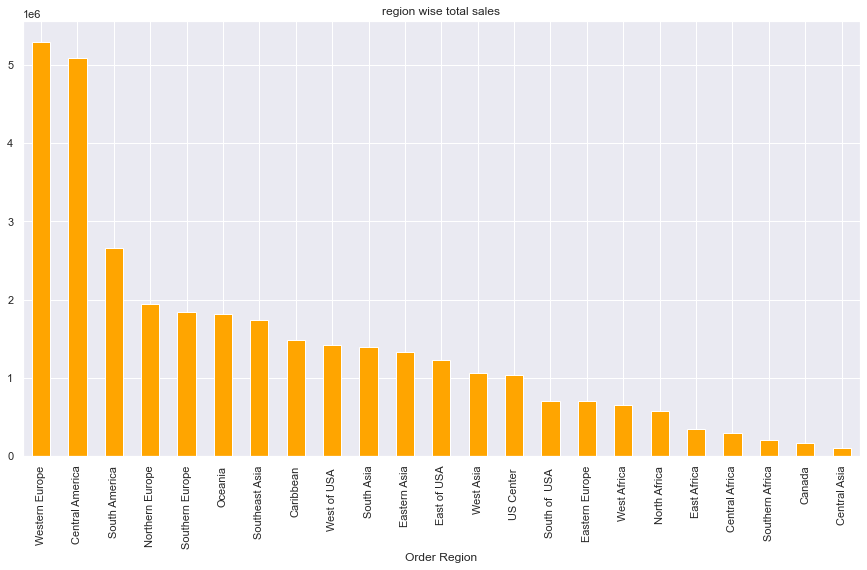

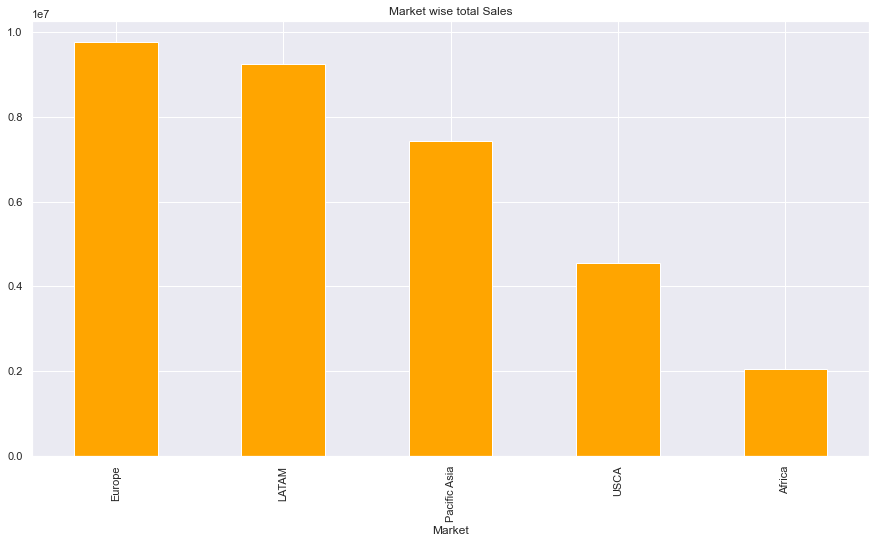

In [15]:
R_Area = df.groupby('Order Region')
M_Area = df.groupby('Market')
plt.figure(1)
R_Area['Sales per customer'].sum().sort_values(ascending=False).plot.bar(figsize=(15,8),color='orange', title="region wise total sales")
plt.figure(2)
M_Area['Sales per customer'].sum().sort_values(ascending=False).plot.bar(figsize=(15,8),color='orange', title="Market wise total Sales")



# sns.set(rc={'figure.figsize':(11.7,8.27)})

# plt.subplot( 1, 2, 1 )
# sns.countplot( R_Area['Sales per customer'] )

# plt.subplot( 1, 2, 2 )
# sns.countplot( M_Area['Sales per customer'] )
# sns.kdeplot( Life_Exp[Life_Exp['continent'] =='Oceania']['Life expectancy'], label='continent', shade=True )
# sns.kdeplot( Life_Exp[Life_Exp['continent'] =='Africa']['Life expectancy'], label='continent', shade=True )
# sns.kdeplot( Life_Exp[Life_Exp['continent'] =='North America']['Life expectancy'], label='continent', shade=True )
# sns.kdeplot( Life_Exp[Life_Exp['continent'] =='South America']['Life expectancy'], label='continent', shade=True )
# sns.kdeplot( Life_Exp[Life_Exp['continent'] =='Europe']['Life expectancy'], label='continent', shade=True )
# sns.kdeplot( Life_Exp[Life_Exp['continent'] =='Asia']['Life expectancy'], label='continent', shade=True )
# sns.kdeplot( Life_Exp[Life_Exp['continent'] =='Unknown']['Life expectancy'], label='continent', shade=True );



From the above graph it is clearly visible that the Western Europe regions market has the highest sales and Africa market has the least sales. So, we will further explore the product category with the highest sales.

<AxesSubplot:title={'center':'Total sales per Ctaegory'}, xlabel='Category Name'>

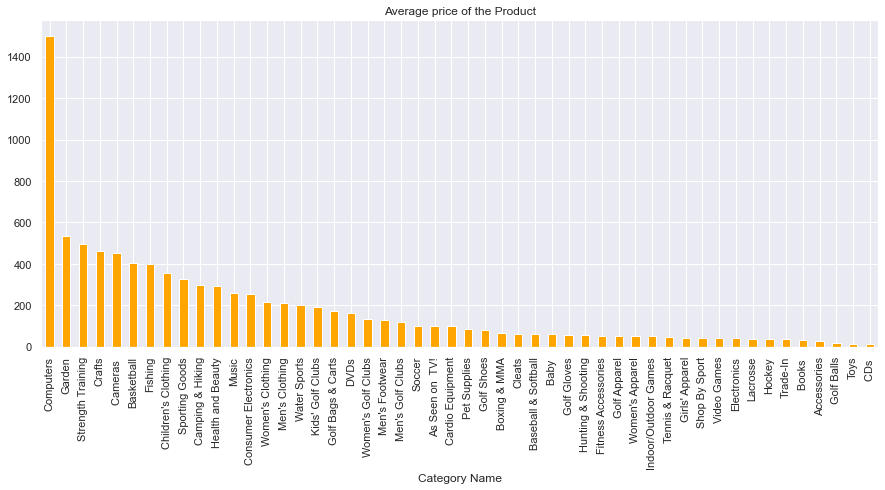

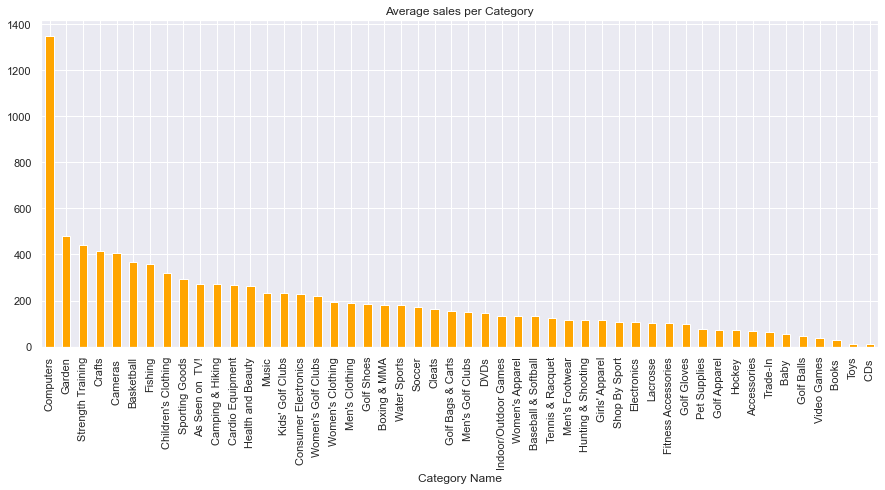

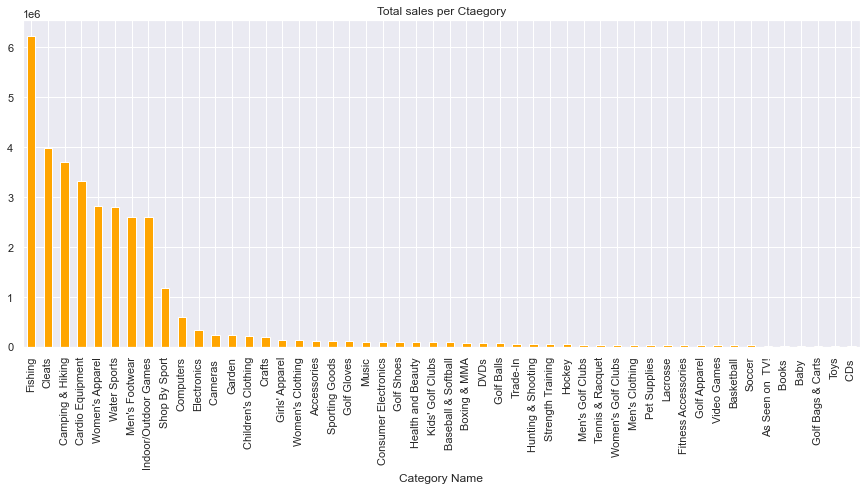

In [16]:
P_Cat= df.groupby('Category Name')
plt.figure(1)
P_Cat['Product Price'].mean().sort_values(ascending=False).plot.bar(figsize=(15,6),color='orange', title="Average price of the Product")
plt.figure(2)
P_Cat['Sales per customer'].mean().sort_values(ascending=False).plot.bar(figsize=(15,6),color='orange', title="Average sales per Category")
plt.figure(3)
P_Cat['Sales per customer'].sum().sort_values(ascending=False).plot.bar(figsize=(15,6),color='orange', title="Total sales per Ctaegory")

It can be observed from fig that most number of sales are in fishing followed by Cleats.
Its interesting to note that despite the higher unit price some categories still sell in high volumes ex : computers.

In [17]:
import plotly.express as px
fig = px.scatter(df, x="Product Price", y="Sales per customer",
	         size="Sales", color="Order Region", hover_name="Category Name", log_x=True, 
                 size_max=80,title="Product Price Vs Sales per customer as per the Region")
fig.show()

As with the graph shown above, it is clear that Product Price has a linear relationship with sales per customer and sales are high for products with higher product price.

In [18]:
df['order_year']= pd.DatetimeIndex(df['order date (DateOrders)']).year
df['order_month'] = pd.DatetimeIndex(df['order date (DateOrders)']).month
df['order_hour'] = pd.DatetimeIndex(df['order date (DateOrders)']).hour
df['order_month_year'] = pd.to_datetime(df['order date (DateOrders)']).dt.to_period('M')
df['order_week_day'] = pd.DatetimeIndex(df['order date (DateOrders)']).weekday

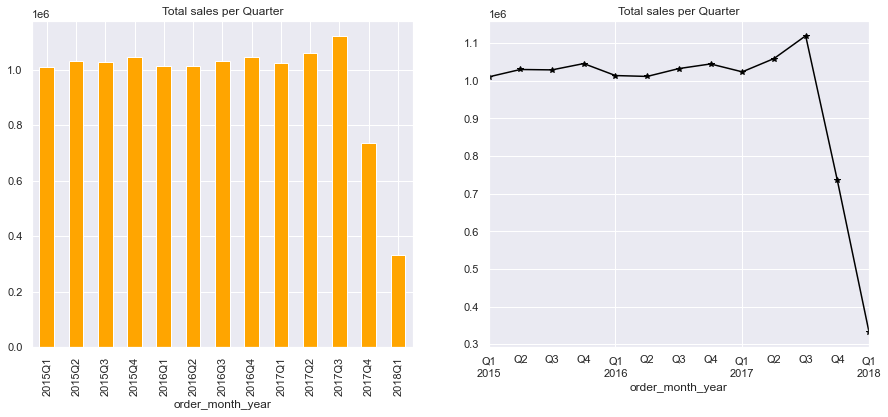

In [19]:
Q= df.groupby('order_month_year')
fig, ax = plt.subplots()
plt.rcParams["figure.autolayout"] = True

plt.subplot( 1, 2,1)

plt.title('Total sales per Quarter')
Q['Sales'].sum().resample('Q').mean().plot(kind='bar',figsize=(15,6),color='orange')
plt.subplot( 1, 2, 2 )

plt.title('Total sales per Quarter')
Q['Sales'].sum().resample('Q').mean().plot(kind='line',figsize=(15,6),color='black',  marker='*')

plt.show()

By seeing above graph it can be seen that sales are consistent from Q1 2015 to Q3 2017 until  Q1 2018 as there is a sudden decrease in sales from the starting of 2018.

## Exploratoratory Data Analysis with respect to Suspected Fraud Data

Analyzing the different payment methods in order to find out the Suspected fraud

In [20]:
df['Type'].unique()

array(['DEBIT', 'TRANSFER', 'CASH', 'PAYMENT'], dtype=object)

Text(0.5, 1.0, 'Most Preferred Payment Type')

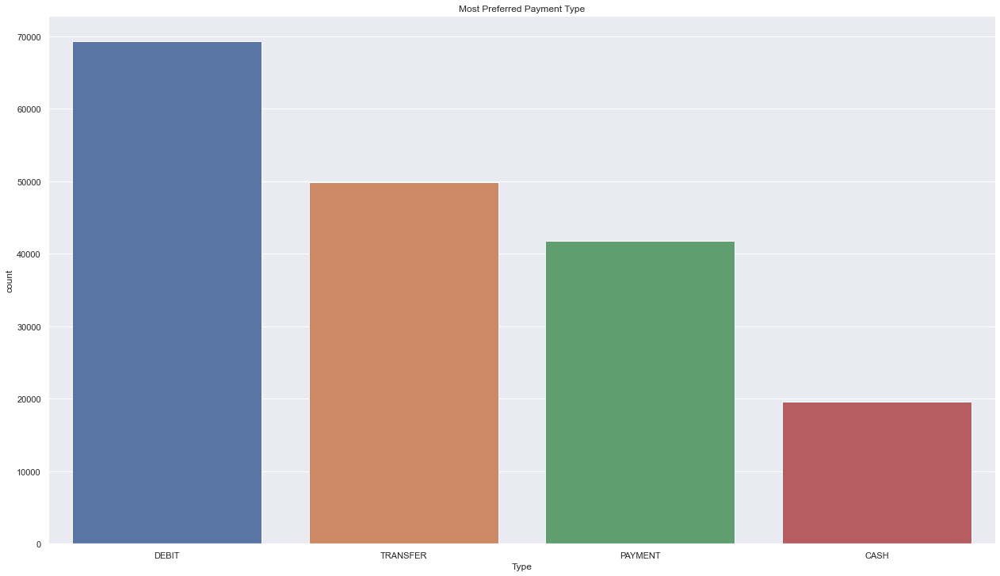

In [21]:
ax=sns.countplot( df['Type'], order = df['Type'].value_counts().index)
ax.set_title("Most Preferred Payment Type")

Text(0.5, 1.0, 'Order Region with their Payment Type')

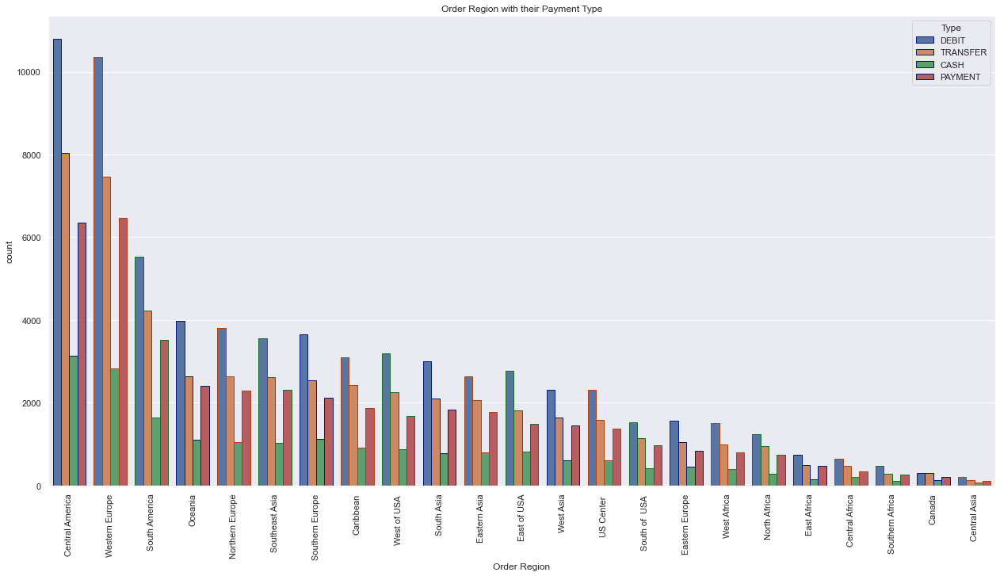

In [22]:
ax=sns.countplot(x=df['Order Region'], hue=df['Type'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=df,order = df['Order Region'].value_counts().index)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)
ax.set_title("Order Region with their Payment Type")

As from this graph it is clear that the Debit payment method is most common among all the regions and cash is less preferred.

There are some products which are having negative benefit per order which is causing loss to the company. So, we have to find out the product category and the order region in which this loss is happening.

Total revenue loss due to negative benfit per orders:  -3883547.345768667


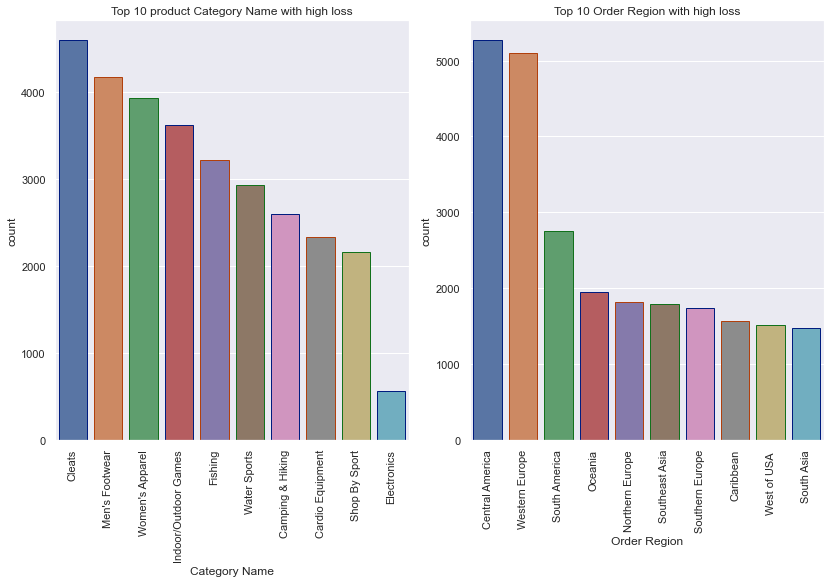

In [23]:
Neg_Ben = df[(df['Benefit per order']<0)]

sns.set(rc={'figure.figsize':(11.7,8.27)})

plt.subplot( 1, 2, 1 )
ax=sns.countplot(x=Neg_Ben['Category Name'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=Neg_Ben,order = Neg_Ben['Category Name'].value_counts().iloc[:10].index)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)
ax.set_title("Top 10 product Category Name with high loss")
plt.subplot( 1, 2, 2 )
ax=sns.countplot(x=Neg_Ben['Order Region'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=Neg_Ben,order = Neg_Ben['Order Region'].value_counts().iloc[:10].index)

ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)
ax.set_title("Top 10 Order Region with high loss")

print('Total revenue loss due to negative benfit per orders: ',Neg_Ben['Benefit per order'].sum())

Total loss in revenue due to orders is 3883547 approximately and it is basically due to the product categories 'Cleats' and 'Men's Footwear'. These losses are generally confined to Central America and Western Europe region. So, these losses may have happened due to delay in deliveries i.e. late delivery or due to suspected frauds.

Therefore, we will try to find out the mode of payment of these losses in order to know the reason and prevent it.

Text(0.5, 1.0, 'Payment Type with Suspected Fraud')

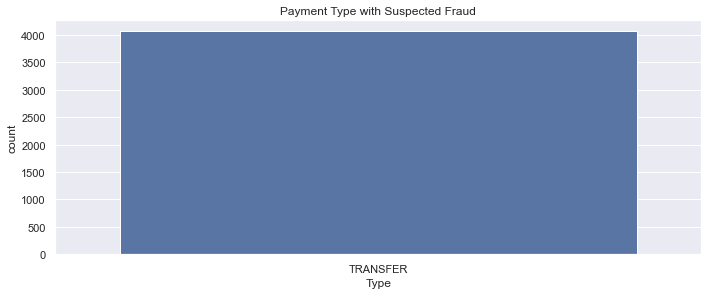

In [24]:
fraud = df[(df['Order Status'] == 'SUSPECTED_FRAUD')]

sns.set(rc={'figure.figsize':(10,4.27)})
ax=sns.countplot(x=fraud['Type'],data=fraud)
ax.set_title("Payment Type with Suspected Fraud")

As it is clearly seen that the payment type transfer is  suspected as fraud. So,we will further investigate it and find the regions and the product categories associated with that. 

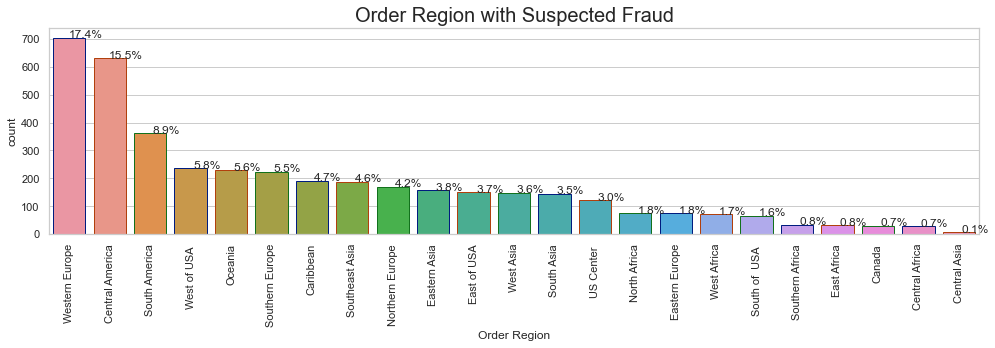

In [25]:
sns.set(style="whitegrid")
plt.figure(figsize=(14,5))
total = float(len(fraud))
ax=sns.countplot(x=fraud['Order Region'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=fraud,order = fraud['Order Region'].value_counts().index)
plt.title('Order Region with Suspected Fraud', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total)
    x = p.get_x() + p.get_width()
    y = p.get_height()
    ax.annotate(percentage, (x, y),ha='center')
plt.show()

##### From this graph it is clearly visible that the Western Europe has the highest percentage of probable suspected fraud of 17.4% followed by Central America with 15.5%.

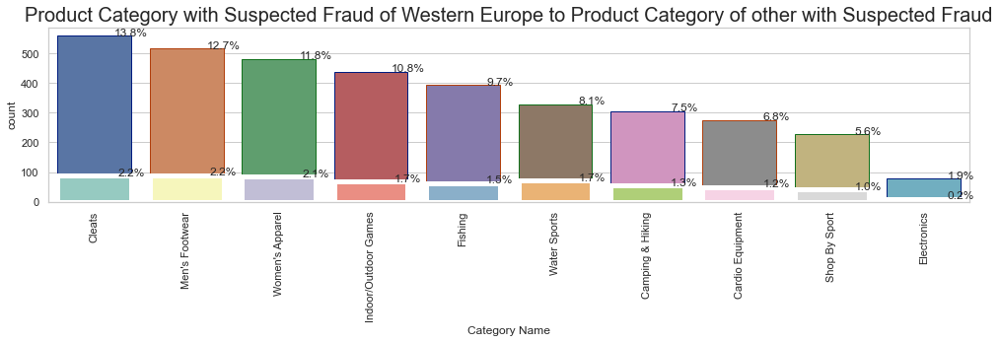

In [26]:
Fraud_WE=fraud[(fraud['Order Region'] == 'Western Europe')]
sns.set(style="whitegrid")
plt.figure(figsize=(14,5))
total = float(len(fraud))
ax=sns.countplot(x=fraud['Category Name'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=fraud,order = fraud['Category Name'].value_counts().iloc[:10].index)
ax=sns.countplot(x=Fraud_WE['Category Name'],
                   linewidth=5,palette="Set3",data=Fraud_WE,order = fraud['Category Name'].value_counts().iloc[:10].index)
plt.title('Product Category with Suspected Fraud of Western Europe to Product Category of other with Suspected Fraud', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total)
    x = p.get_x() + p.get_width()
    y = p.get_height()
    ax.annotate(percentage, (x, y),ha='center')
plt.show()


Cleats and Men's Footwear is leading in terms of Suspected fraud in Western Europe as well as other Order Regions. So, we can investigate further and narrow down some customers doing the fraud in these regions for these product categories.

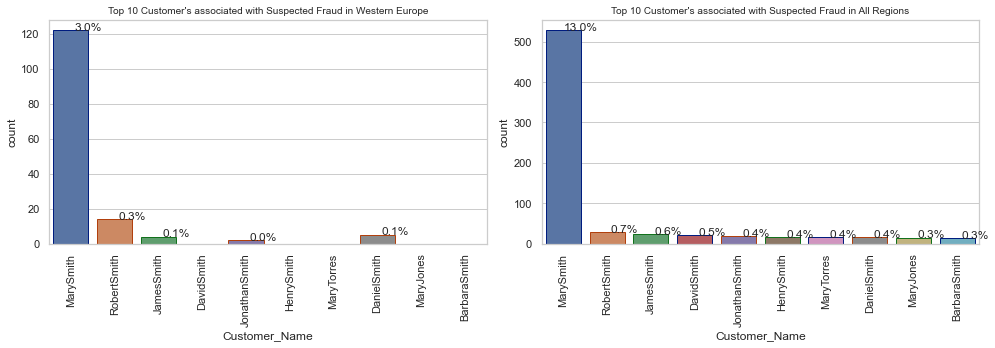

In [27]:
sns.set(style="whitegrid")
plt.figure(figsize=(14,5))
total = float(len(fraud))
plt.subplot( 1, 2, 1 )
ax=sns.countplot(x=Fraud_WE['Customer_Name'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=Fraud_WE,order = fraud['Customer_Name'].value_counts().iloc[:10].index)
plt.title("Top 10 Customer's associated with Suspected Fraud in Western Europe", fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total)
    x = p.get_x() + p.get_width()
    y = p.get_height()
    ax.annotate(percentage, (x, y),ha='center')
plt.subplot( 1, 2, 2)

ax=sns.countplot(x=fraud['Customer_Name'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=fraud,order = fraud['Customer_Name'].value_counts().iloc[:10].index)
plt.title("Top 10 Customer's associated with Suspected Fraud in All Regions", fontsize=10)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total)
    x = p.get_x() + p.get_width()
    y = p.get_height()
    ax.annotate(percentage, (x, y),ha='center')
plt.show()


Mary Smith customer alone has conducted 3%(around 120 cases) of the total fraud in Western Europe and 13%(around 520 cases) of the total Fraud in the whole regions. By this we can conclude that Mary Smith must have changed her address in order to commit fraud as his name is present in more than one regions.Further, we can also investigate the fraud amount.

In [28]:
Fraud_Amount = fraud[(fraud['Customer_Name'] == 'MarySmith')]

Fraud_Amount['Sales'].sum()

102491.66191043999

102K thousand is a huge amount that is made by Mary Smith across all regions by using different addresses and probably different id's due to change in address every time. So, all factors should be taken into consideration while identification of fraud cases more accurately.

## Exploratoratory Data Analysis with respect to Late Delivery Data

Delivering products to customer on time without late delivery is another important aspect for a supply chain company because customers will not be satisfied if products are not delivered on time. So, identifying the product categories which are not delivered on time and where there is late delivery risk associated.

Text(0.5, 1.0, 'Top 10 Prodcts Category Name with Late Deliveries')

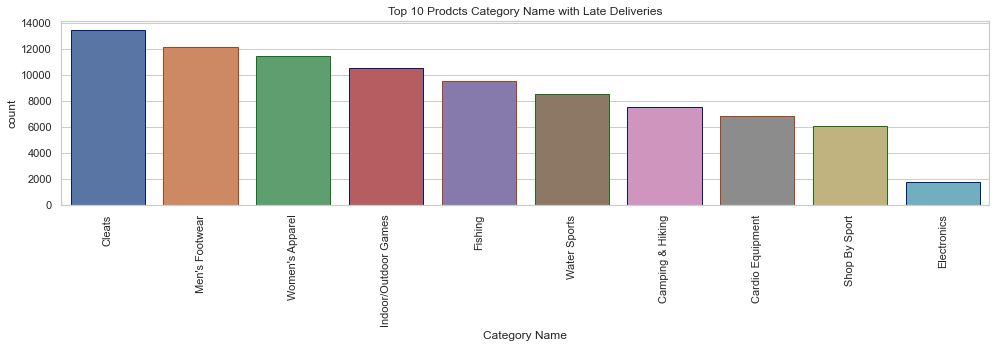

In [29]:
late_delivery = df[(df['Delivery Status'] == 'Late delivery')]
sns.set(style="whitegrid")
plt.figure(figsize=(14,5))
ax=sns.countplot(x=late_delivery['Category Name'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=late_delivery,order = Neg_Ben['Category Name'].value_counts().iloc[:10].index)

ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)
ax.set_title("Top 10 Prodcts Category Name with Late Deliveries")

Product Category Name cleats is getting delayed teh most followed by Men's footwear. 

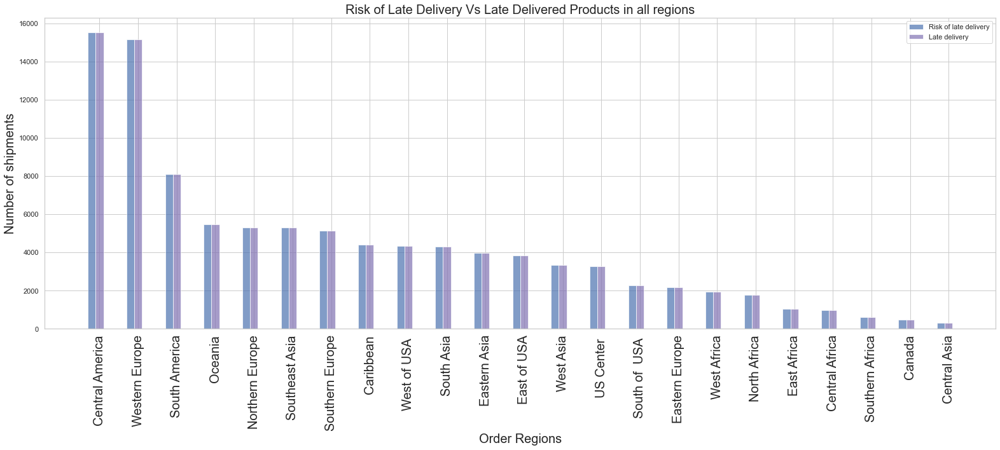

In [30]:
late_delivery_risk = df[(df['Late_delivery_risk'] == 1)]

Reg_name=df['Order Region'].value_counts().keys()
n_groups=23
fig,ax = plt.subplots(figsize=(22,10)) 
index=np.arange(n_groups)
bar_width=0.2
ax1=plt.bar(index,late_delivery_risk['Order Region'].value_counts(),bar_width,alpha=0.7,color='b',label='Risk of late delivery')
ax2=plt.bar(index+bar_width,late_delivery['Order Region'].value_counts(),bar_width,alpha=0.7,color='m',label='Late delivery')
plt.xlabel('Order Regions',fontsize=20)
plt.ylabel('Number of shipments',fontsize=20)
plt.title('Risk of Late Delivery Vs Late Delivered Products in all regions',fontsize=20)
plt.legend()
plt.xticks(index+bar_width,Reg_name,rotation=90,fontsize=20)
plt.tight_layout()
plt.show()

From this it is clear that the products marked with late delivery risk are actually delivered late across all regions. So, we should change the shipment method to avoid late deliveries. For that we should also explore late deliveries across each shipment mode in all regions.

In [31]:
late_delivery['Shipping Mode'].unique()

array(['Standard Class', 'First Class', 'Second Class', 'Same Day'],
      dtype=object)

Text(0.5, 1.0, 'Shipment Modes with Late Deliveries')

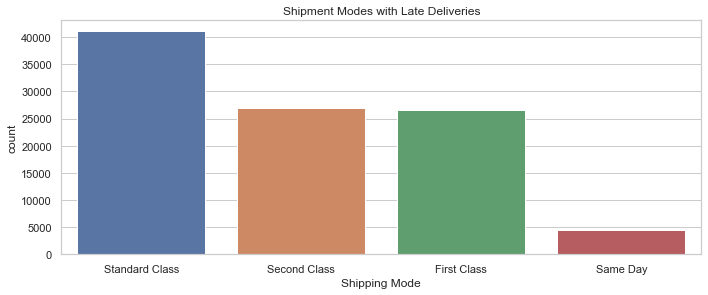

In [32]:
ax=sns.countplot( late_delivery['Shipping Mode'], order = late_delivery['Shipping Mode'].value_counts().index)
ax.set_title("Shipment Modes with Late Deliveries")

Text(0.5, 1.0, 'Order Region with their late deliveries due to their Shipment Type')

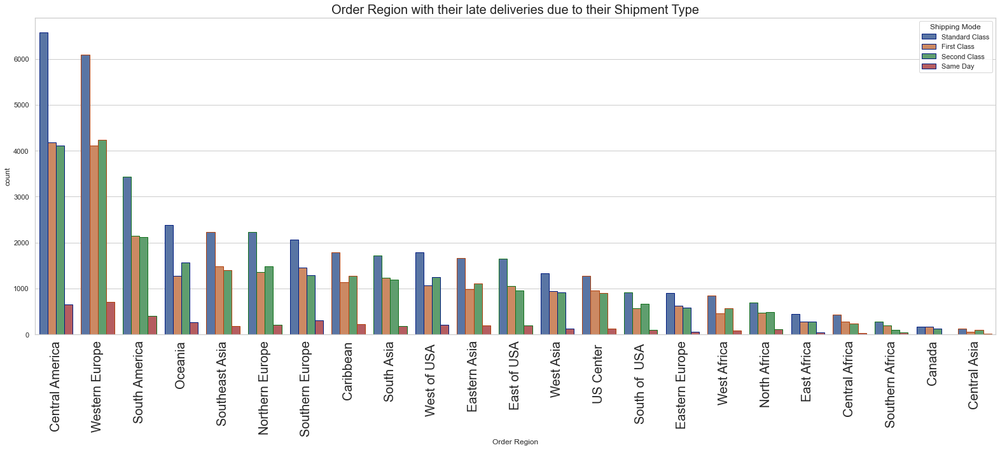

In [33]:
fig,ax = plt.subplots(figsize=(22,10)) 
ax=sns.countplot(x=late_delivery['Order Region'], hue=df['Shipping Mode'],
                   linewidth=1,
                   edgecolor=sns.color_palette("dark", 3), data=late_delivery,order = late_delivery['Order Region'].value_counts().index)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90,fontsize=20)
ax.set_title("Order Region with their late deliveries due to their Shipment Type",fontsize=20)

It is found that four types of shipment methods are used and standard class shipment method is causing the most late deliveries followed by Second class and First Class whereas Same has the least late deliveries across all regions.

# Data Modelling

Model is being trained to predict late deliveries and fraud detection for classification algorithm using Decision tree algorithm.

In [34]:
train_data=df.copy()

Decoding the Suspected fraud data present in order status column and late delivery data present in delivery status column as one respectively and other as zero and storing it in new colum fraud and late delivery.

In [35]:
train_data['fraud'] = np.where(train_data['Order Status'] == 'SUSPECTED_FRAUD', 1, 0)
train_data['late_delivery']=np.where(train_data['Delivery Status'] == 'Late delivery', 1, 0)

In [36]:
train_data.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,...,Product Price,Shipping Mode,Customer_Name,order_year,order_month,order_hour,order_month_year,order_week_day,fraud,late_delivery
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,...,327.75,Standard Class,CallyHolloway,2018,1,22,2018-01,2,0,0
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,...,327.75,Standard Class,IreneLuna,2018,1,12,2018-01,5,0,1
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,...,327.75,Standard Class,GillianMaldonado,2018,1,12,2018-01,5,0,0
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,...,327.75,Standard Class,TanaTate,2018,1,11,2018-01,5,0,0
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,...,327.75,Standard Class,OrliHendricks,2018,1,11,2018-01,5,0,0


### Spliting Target Column

For Fraud Detection

In [37]:
x_fraud=train_data.loc[:, train_data.columns != 'fraud']
y_fraud=train_data['fraud']

For Late Delivery Prediction

In [38]:
x_late=train_data.loc[:, train_data.columns != 'late_delivery']
y_late=train_data['late_delivery']

## Checking Data Correlation

In [39]:
def handling_correlation(X_train,threshold=0.7):
    corr_features = set()
    corr_matrix = X_train.corr()
    for i in range(len(corr_matrix .columns)):
        for j in range(i):
            if ((abs(corr_matrix.iloc[i, j]) >threshold) or (abs(corr_matrix.iloc[i, j]) < -(threshold))) :
                colname = corr_matrix.columns[i]
                corr_features.add(colname)
    return list(corr_features)

For Fraud Detection

In [40]:
df_fraud_drop=handling_correlation(x_fraud,0.8)
df_fraud_drop

['Order Item Total',
 'order_year',
 'Product Card Id',
 'Order Item Profit Ratio',
 'Product Price',
 'Product Category Id',
 'Sales',
 'Order Item Cardprod Id',
 'late_delivery',
 'Order Profit Per Order',
 'Order Item Id',
 'Order Customer Id',
 'Department Id']

In [41]:
x_fraud=x_fraud.drop(df_fraud_drop,axis=1)

<AxesSubplot:title={'center':'Pearson Correlation of Features'}>

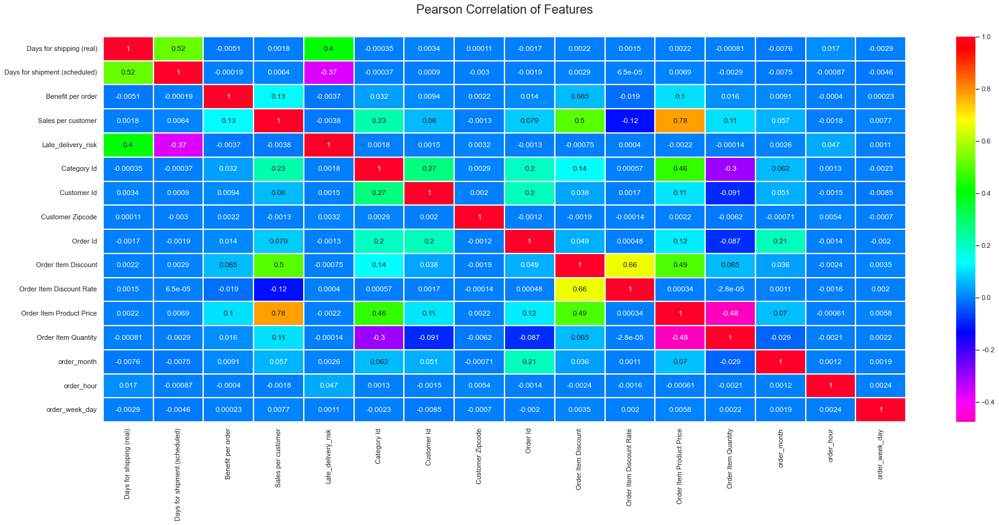

In [42]:
colormap = plt.cm.RdBu
plt.figure(figsize=(25,12))
plt.title('Pearson Correlation of Features', y=1.05, size=20)
sns.heatmap(x_fraud.corr(),linewidths=0.1,vmax=1.0, fmt='.2g',
         cmap='gist_rainbow_r', linecolor='white', annot=True)

There are some columns with object type data which cannot be trained in machine learning models so all the object type data is converted to int type using preprocessing label encoder library.

In [43]:
x_fraud.dtypes

Type                                object
Days for shipping (real)             int64
Days for shipment (scheduled)        int64
Benefit per order                  float64
Sales per customer                 float64
Delivery Status                     object
Late_delivery_risk                   int64
Category Id                          int64
Category Name                       object
Customer City                       object
Customer Country                    object
Customer Id                          int64
Customer Segment                    object
Customer State                      object
Customer Zipcode                   float64
Department Name                     object
Market                              object
Order City                          object
Order Country                       object
order date (DateOrders)             object
Order Id                             int64
Order Item Discount                float64
Order Item Discount Rate           float64
Order Item 

Dropping less significant columns like 'Delivery Status','Late_delivery_risk','Order Status','order_month_year','order date (DateOrders)' because we have already created new columns for this.

In [44]:
#Dropping columns with repeated values
x_fraud.drop(['Delivery Status','Late_delivery_risk','Order Status','order_month_year','order date (DateOrders)'], axis=1, inplace=True)

It is important to check the type of variables in the data because machine learning models can only be trained with numerical values.

In [45]:
from sklearn.preprocessing import LabelEncoder
business_coder = LabelEncoder()

x_fraud['Customer Country']  = business_coder.fit_transform(x_fraud['Customer Country'])
x_fraud['Market']            = business_coder.fit_transform(x_fraud['Market'])
x_fraud['Type']              = business_coder.fit_transform(x_fraud['Type'])
x_fraud['Product Name']      = business_coder.fit_transform(x_fraud['Product Name'])
x_fraud['Customer Segment']  = business_coder.fit_transform(x_fraud['Customer Segment'])
x_fraud['Customer State']    = business_coder.fit_transform(x_fraud['Customer State'])
x_fraud['Order Region']      = business_coder.fit_transform(x_fraud['Order Region'])
x_fraud['Order City']        = business_coder.fit_transform(x_fraud['Order City'])
x_fraud['Category Name']     = business_coder.fit_transform(x_fraud['Category Name'])
x_fraud['Customer City']     = business_coder.fit_transform(x_fraud['Customer City'])
x_fraud['Department Name']   = business_coder.fit_transform(x_fraud['Department Name'])
x_fraud['Order State']       = business_coder.fit_transform(x_fraud['Order State'])
x_fraud['Shipping Mode']     = business_coder.fit_transform(x_fraud['Shipping Mode'])
x_fraud['order_week_day']    = business_coder.fit_transform(x_fraud['order_week_day'])
x_fraud['Order Country']     = business_coder.fit_transform(x_fraud['Order Country'])
x_fraud['Customer_Name']= business_coder.fit_transform(x_fraud['Customer_Name'])

x_fraud.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Category Id,Category Name,Customer City,Customer Country,Customer Id,...,Order Item Product Price,Order Item Quantity,Order Region,Order State,Product Name,Shipping Mode,Customer_Name,order_month,order_hour,order_week_day
0,1,3,4,91.250000,314.640015,73,40,66,1,20755,...,327.75,1,15,475,78,3,1876,1,22,2
1,3,5,4,-249.089996,311.359985,73,40,66,1,19492,...,327.75,1,13,841,78,3,5378,1,12,5
2,0,4,4,-247.779999,309.720001,73,40,452,0,19491,...,327.75,1,13,841,78,3,4429,1,12,5
3,1,3,4,22.860001,304.809998,73,40,285,0,19490,...,327.75,1,11,835,78,3,12929,1,11,5
4,2,2,4,134.210007,298.250000,73,40,66,1,19489,...,327.75,1,11,835,78,3,10638,1,11,5


In [46]:
x_fraud.dtypes

Type                               int32
Days for shipping (real)           int64
Days for shipment (scheduled)      int64
Benefit per order                float64
Sales per customer               float64
Category Id                        int64
Category Name                      int32
Customer City                      int32
Customer Country                   int32
Customer Id                        int64
Customer Segment                   int32
Customer State                     int32
Customer Zipcode                 float64
Department Name                    int32
Market                             int32
Order City                         int32
Order Country                      int32
Order Id                           int64
Order Item Discount              float64
Order Item Discount Rate         float64
Order Item Product Price         float64
Order Item Quantity                int64
Order Region                       int32
Order State                        int32
Product Name    

For Late Delivery Prediction

In [47]:
df_late_drop=handling_correlation(x_late,0.8)
df_late_drop

['Order Item Total',
 'order_year',
 'Product Card Id',
 'Order Item Profit Ratio',
 'Product Price',
 'Product Category Id',
 'Sales',
 'Order Item Cardprod Id',
 'Order Profit Per Order',
 'Order Item Id',
 'Order Customer Id',
 'Department Id']

In [48]:
x_late=x_late.drop(df_late_drop,axis=1)

<AxesSubplot:title={'center':'Pearson Correlation of Features'}>

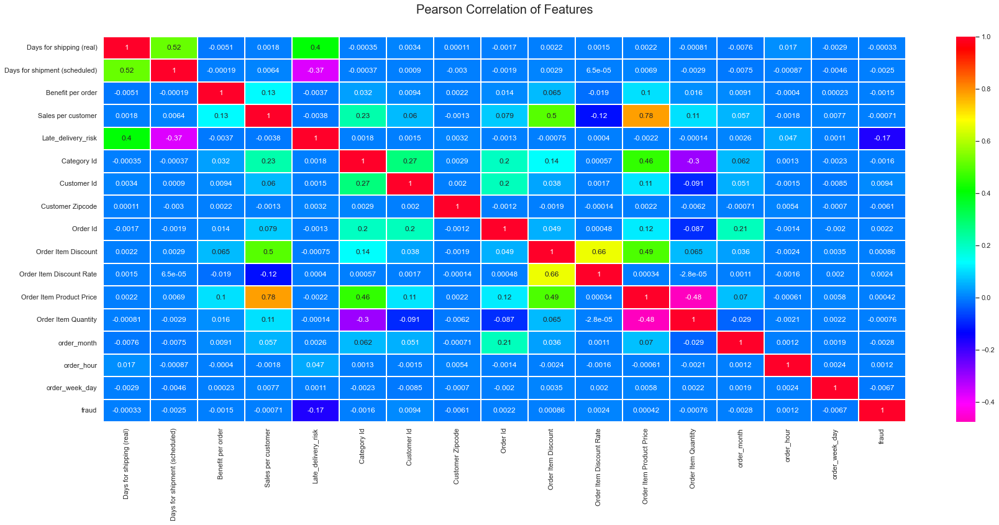

In [49]:
colormap = plt.cm.RdBu
plt.figure(figsize=(25,12))
plt.title('Pearson Correlation of Features', y=1.05, size=20)
sns.heatmap(x_late.corr(),linewidths=0.1,vmax=1.0, fmt='.2g',
         cmap='gist_rainbow_r', linecolor='white', annot=True)

There are some columns with object type data which cannot be trained in machine learning models so all the object type data is converted to int type using preprocessing label encoder library.

In [50]:
x_late.dtypes

Type                                object
Days for shipping (real)             int64
Days for shipment (scheduled)        int64
Benefit per order                  float64
Sales per customer                 float64
Delivery Status                     object
Late_delivery_risk                   int64
Category Id                          int64
Category Name                       object
Customer City                       object
Customer Country                    object
Customer Id                          int64
Customer Segment                    object
Customer State                      object
Customer Zipcode                   float64
Department Name                     object
Market                              object
Order City                          object
Order Country                       object
order date (DateOrders)             object
Order Id                             int64
Order Item Discount                float64
Order Item Discount Rate           float64
Order Item 

Dropping less significant columns like 'Delivery Status','Late_delivery_risk','Order Status','order_month_year','order date (DateOrders)' and 'fraud' because we have already created new columns for this.

In [51]:
x_late.drop(['Delivery Status','Late_delivery_risk','Order Status','order_month_year','order date (DateOrders)','fraud'], axis=1, inplace=True)

It is important to check the type of variables in the data because machine learning models can only be trained with numerical values.

In [52]:
from sklearn.preprocessing import LabelEncoder
business_coder = LabelEncoder()

x_late['Customer Country']  = business_coder.fit_transform(x_late['Customer Country'])
x_late['Market']            = business_coder.fit_transform(x_late['Market'])
x_late['Type']              = business_coder.fit_transform(x_late['Type'])
x_late['Product Name']      = business_coder.fit_transform(x_late['Product Name'])
x_late['Customer Segment']  = business_coder.fit_transform(x_late['Customer Segment'])
x_late['Customer State']    = business_coder.fit_transform(x_late['Customer State'])
x_late['Order Region']      = business_coder.fit_transform(x_late['Order Region'])
x_late['Order City']        = business_coder.fit_transform(x_late['Order City'])
x_late['Category Name']     = business_coder.fit_transform(x_late['Category Name'])
x_late['Customer City']     = business_coder.fit_transform(x_late['Customer City'])
x_late['Department Name']   = business_coder.fit_transform(x_late['Department Name'])
x_late['Order State']       = business_coder.fit_transform(x_late['Order State'])
x_late['Shipping Mode']     = business_coder.fit_transform(x_late['Shipping Mode'])
x_late['order_week_day']    = business_coder.fit_transform(x_late['order_week_day'])
x_late['Order Country']     = business_coder.fit_transform(x_late['Order Country'])
x_late['Customer_Name']= business_coder.fit_transform(x_late['Customer_Name'])

x_late.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Category Id,Category Name,Customer City,Customer Country,Customer Id,...,Order Item Product Price,Order Item Quantity,Order Region,Order State,Product Name,Shipping Mode,Customer_Name,order_month,order_hour,order_week_day
0,1,3,4,91.250000,314.640015,73,40,66,1,20755,...,327.75,1,15,475,78,3,1876,1,22,2
1,3,5,4,-249.089996,311.359985,73,40,66,1,19492,...,327.75,1,13,841,78,3,5378,1,12,5
2,0,4,4,-247.779999,309.720001,73,40,452,0,19491,...,327.75,1,13,841,78,3,4429,1,12,5
3,1,3,4,22.860001,304.809998,73,40,285,0,19490,...,327.75,1,11,835,78,3,12929,1,11,5
4,2,2,4,134.210007,298.250000,73,40,66,1,19489,...,327.75,1,11,835,78,3,10638,1,11,5


In [53]:
x_late.dtypes

Type                               int32
Days for shipping (real)           int64
Days for shipment (scheduled)      int64
Benefit per order                float64
Sales per customer               float64
Category Id                        int64
Category Name                      int32
Customer City                      int32
Customer Country                   int32
Customer Id                        int64
Customer Segment                   int32
Customer State                     int32
Customer Zipcode                 float64
Department Name                    int32
Market                             int32
Order City                         int32
Order Country                      int32
Order Id                           int64
Order Item Discount              float64
Order Item Discount Rate         float64
Order Item Product Price         float64
Order Item Quantity                int64
Order Region                       int32
Order State                        int32
Product Name    

Now all the data is transformed into int type. The dataset is split into train data and test data so model can be trained with train data and the performance of model can be evaluated using test data.

# Train_Test Split 

### Fraud Detection

In [54]:
x_fraud_train, x_fraud_test,y_fraud_train,y_fraud_test = train_test_split(x_fraud,y_fraud,test_size = 0.25,random_state = 44)

### Late Delivery Prediction

In [55]:
x_late_train, x_late_test,y_late_train,y_late_test = train_test_split(x_late,y_late,test_size = 0.25, random_state = 44)

Since there are so many different variables with different ranges standard scaler is used to standardize total the data so it is internally consistent before training the data with machine learning.

### Scaling the Fraud independent variables and Traget independent variables

In [56]:
Std = StandardScaler()
x_fraud_train=Std.fit_transform(x_fraud_train)
x_fraud_test=Std.transform(x_fraud_test)
x_late_train=Std.fit_transform(x_late_train)
x_late_test=Std.transform(x_late_test)

### Decision tree classification

#### For Fraud detection

In [57]:
tree_fraud= tree.DecisionTreeClassifier()

# Fitting train data for fraud detection
tree_fraud=tree_fraud.fit(x_fraud_train,y_fraud_train) 
y_fraud_pred=tree_fraud.predict(x_fraud_test)

 #Accuracy for fraud detection
accuracy_fraud=accuracy_score(y_fraud_pred, y_fraud_test)

#Recall score for  fraud detection
recall_fraud=recall_score(y_fraud_pred, y_fraud_test) 

# Confusion Matrix for fraud detection
conf_mat_fraud=confusion_matrix(y_fraud_test, y_fraud_pred)

# f1_score for fraud detection
f1_fraud=f1_score(y_fraud_test, y_fraud_pred)
    
print('Decision Tree Classifier for fraud detection')
print('fraud Prediction Accuracy  :', (accuracy_fraud)*100,'%')
print('fraud Prediction Recall score of fraud status is        :', (recall_fraud)*100,'%')
print('fraud Prediction Confusion Matrix :\n',  (conf_mat_fraud))
print('F1 score of fraud Prediction      :', (f1_fraud)*100,'%')

Decision Tree Classifier for fraud detection
fraud Prediction Accuracy  : 98.62397518280524 %
fraud Prediction Recall score of fraud status is        : 67.36842105263158 %
fraud Prediction Confusion Matrix :
 [[43805   341]
 [  280   704]]
F1 score of fraud Prediction      : 69.39379004435683 %


#### For Late Deliveries

In [58]:
tree_late= tree.DecisionTreeClassifier()

# Fitting train data for fraud detection
tree_late=tree_late.fit(x_late_train,y_late_train) 
y_late_pred=tree_late.predict(x_late_test)

 #Accuracy for fraud detection
accuracy_late=accuracy_score(y_late_pred, y_late_test)

#Recall score for  fraud detection
recall_late=recall_score(y_late_pred, y_late_test) 

# Confusion Matrix for fraud detection
conf_mat_late=confusion_matrix(y_late_test, y_late_pred)

# f1_score for fraud detection
f1_late=f1_score(y_late_test, y_late_pred)
    
print('Decision Tree Classifier for late delivery prediction')
print('Late Delivery Prediction accuracy        :', (accuracy_late)*100,'%')
print('Late Delivery Prediction Recall score        :', (recall_late)*100,'%')
print('Late Delivery Prediction Confusion Matrix       :\n',  (conf_mat_late))
print('F1 score of Late Delivery Prediction        :', (f1_late)*100,'%')

Decision Tree Classifier for late delivery prediction
Late Delivery Prediction accuracy        : 98.69709727454021 %
Late Delivery Prediction Recall score        : 98.9412897016362 %
Late Delivery Prediction Confusion Matrix       :
 [[19870   264]
 [  324 24672]]
F1 score of Late Delivery Prediction        : 98.8223984619082 %


Considering F1 score it is clear that Decision Tree classifier is performing better for classification type with F1 score of almost 70% for fraud detection and 99.34% for late delivery.Suprisingly, all the models expect gussian model predicted the late delivery of orders with almost 98% accuracy.Just to make sure that model is predicting correctly the model is cross validated and the results are compared with accuracy of the model.

### Cross validation

In [59]:
from sklearn.model_selection import StratifiedKFold
skfold=StratifiedKFold(n_splits=10)
fraud_d_score = cross_val_score(tree_fraud, x_fraud, y_fraud, cv=skfold)
late_p_score = cross_val_score(tree_late, x_late, y_late, cv=skfold)

print('Fraud Detection: Cross validation accuracy is: %0.2f (+/- %0.2f)' % (fraud_d_score.mean(), fraud_d_score.std() * 2))
print('Late Delivery Prediction: Cross validation accuracy is: %0.2f (+/- %0.2f)' % (late_p_score.mean(), late_p_score.std() * 2))

Fraud Detection: Cross validation accuracy is: 0.91 (+/- 0.24)
Late Delivery Prediction: Cross validation accuracy is: 0.96 (+/- 0.07)


Since, the difference between cross validated scores and accuracy scores of the model is very minimal it can be confirmed that the data is neither overfitted or underfitted, Which variable was given more importance in the model is found using feature importance method from sklearn.

### Feature Engineering

#### Fraud Detection

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]),
 [Text(0, 0, 'Customer Id'),
  Text(1, 0, 'Order Id'),
  Text(2, 0, 'Customer_Name'),
  Text(3, 0, 'Order City'),
  Text(4, 0, 'Customer City'),
  Text(5, 0, 'Type'),
  Text(6, 0, 'Customer Zipcode'),
  Text(7, 0, 'Order State'),
  Text(8, 0, 'order_hour'),
  Text(9, 0, 'order_week_day'),
  Text(10, 0, 'Order Country'),
  Text(11, 0, 'order_month'),
  Text(12, 0, 'Days for shipping (real)'),
  Text(13, 0, 'Order Region'),
  Text(14, 0, 'Customer State'),
  Text(15, 0, 'Benefit per order'),
  Text(16, 0, 'Sales per customer'),
  Text(17, 0, 'Customer Segment'),
  Text(18, 0, 'Days for shipment (scheduled)'),
  Text(19, 0, 'Order Item Discount Rate'),
  Text(20, 0, 'Order Item Discount'),
  Text(21, 0, 'Market'),
  Text(22, 0, 'Product Name'),
  Text(23, 0, 'Category Id'),
  Text(24, 0, 'Shipping Mode'),
  Text(25, 0, 'Order Item Product Price'),
  Tex

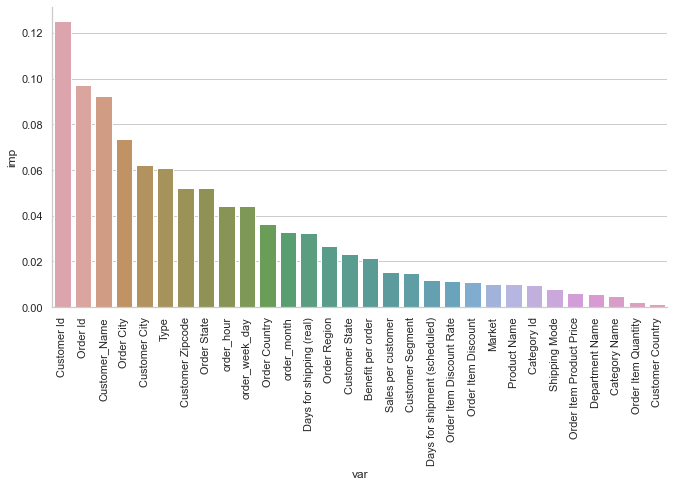

In [60]:
imp_col=tree_fraud.feature_importances_.argsort()
feat_imp=pd.DataFrame({'var':x_fraud.columns[imp_col],'imp':tree_fraud.feature_importances_[imp_col]})
feat_imp=feat_imp.sort_values(by='imp',ascending=False)
ax = sns.catplot(x='var', y = 'imp', data=feat_imp, height=5, aspect=2,saturation=.5,  kind="bar")
plt.xticks(rotation=90)

#### Late Delivery Prediction

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]),
 [Text(0, 0, 'Days for shipping (real)'),
  Text(1, 0, 'Shipping Mode'),
  Text(2, 0, 'Days for shipment (scheduled)'),
  Text(3, 0, 'Type'),
  Text(4, 0, 'Customer Id'),
  Text(5, 0, 'Customer_Name'),
  Text(6, 0, 'Order Id'),
  Text(7, 0, 'Order City'),
  Text(8, 0, 'Order State'),
  Text(9, 0, 'Customer City'),
  Text(10, 0, 'order_hour'),
  Text(11, 0, 'Customer Zipcode'),
  Text(12, 0, 'order_week_day'),
  Text(13, 0, 'Order Country'),
  Text(14, 0, 'order_month'),
  Text(15, 0, 'Customer State'),
  Text(16, 0, 'Order Region'),
  Text(17, 0, 'Customer Segment'),
  Text(18, 0, 'Benefit per order'),
  Text(19, 0, 'Order Item Discount'),
  Text(20, 0, 'Sales per customer'),
  Text(21, 0, 'Category Id'),
  Text(22, 0, 'Market'),
  Text(23, 0, 'Product Name'),
  Text(24, 0, 'Order Item Discount Rate'),
  Text(25, 0, 'Order Item Product Price'),
  Tex

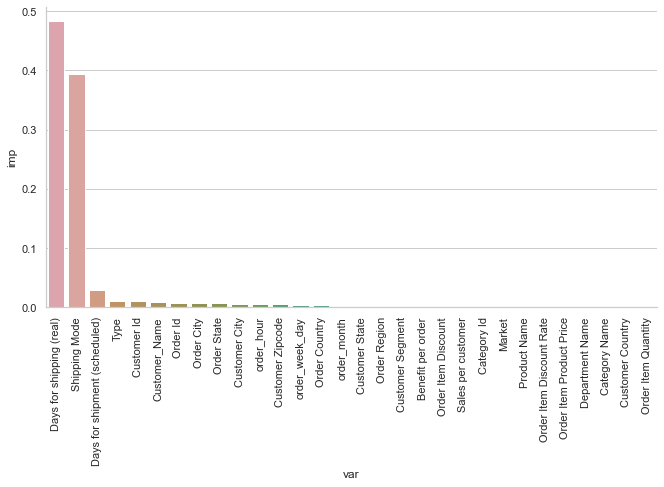

In [61]:
imp_col=tree_late.feature_importances_.argsort()
feat_imp=pd.DataFrame({'var':x_late.columns[imp_col],'imp':tree_late.feature_importances_[imp_col]})
feat_imp=feat_imp.sort_values(by='imp',ascending=False)
ax = sns.catplot(x='var', y = 'imp', data=feat_imp, height=5, aspect=2,saturation=.5,  kind="bar")
plt.xticks(rotation=90)

For Fraud Detection: Customer Id is given much importance of around 0.13 followed by order Id of around 0.10.
For Late Delivery Prediction: Days for shipping(real) is given an importance of 0.48 followed by Shipping Mode of around 0.38.